# Recommendation System Anime

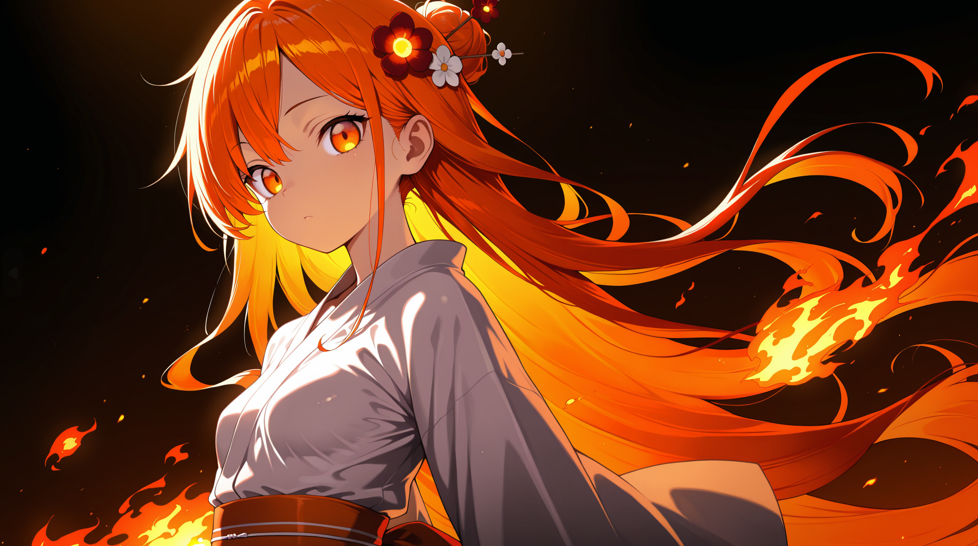

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
# import seaborn as sns
import plotly.graph_objects as go
import matplotlib.image as mpimg
import plotly.express as px
import plotly.io as pio
pio.renderers.default = 'notebook_connected'
pd.set_option('display.max_columns', None)

In [2]:
# read data
anime_info = pd.read_csv('data/anime.csv')
anime_synop = pd.read_csv('data/anime_with_synopsis.csv')
anime_list = pd.read_csv('data/animelist.csv')
rating_complete = pd.read_csv('data/rating_complete.csv')
watching_status = pd.read_csv('data/watching_status.csv')
anime_info.shape,anime_list.shape,anime_synop.shape

((17562, 35), (109224747, 5), (16214, 5))

In [3]:
# info
display(anime_info.head().T),
anime_info.info(),
display(anime_info.describe()),
print('*' * 100),
print('*' * 100),
display(anime_synop.head(3)),
anime_synop.info(),
display(anime_synop.describe()),
print('*' * 100),
print('*' * 100),
display(anime_list.head(3)),
anime_list.info()
display(anime_list.describe()),

,0,1,2,3,4
MAL_ID,1,5,6,7,8
Name,Cowboy Bebop,Cowboy Bebop: Tengoku no Tobira,Trigun,Witch Hunter Robin,Bouken Ou Beet
Score,8.78,8.39,8.24,7.27,6.98
Genres,"Action, Adventure, Comedy, Drama, Sci-Fi, Space","Action, Drama, Mystery, Sci-Fi, Space","Action, Sci-Fi, Adventure, Comedy, Drama, Shounen","Action, Mystery, Police, Supernatural, Drama, ...","Adventure, Fantasy, Shounen, Supernatural"
English name,Cowboy Bebop,Cowboy Bebop:The Movie,Trigun,Witch Hunter Robin,Beet the Vandel Buster
Japanese name,カウボーイビバップ,カウボーイビバップ 天国の扉,トライガン,Witch Hunter ROBIN (ウイッチハンターロビン),冒険王ビィト
Type,TV,Movie,TV,TV,TV
Episodes,26,1,26,26,52
Aired,"Apr 3, 1998 to Apr 24, 1999","Sep 1, 2001","Apr 1, 1998 to Sep 30, 1998","Jul 2, 2002 to Dec 24, 2002","Sep 30, 2004 to Sep 29, 2005"
Premiered,Spring 1998,Unknown,Spring 1998,Summer 2002,Fall 2004


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17562 entries, 0 to 17561
Data columns (total 35 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   MAL_ID         17562 non-null  int64 
 1   Name           17562 non-null  object
 2   Score          17562 non-null  object
 3   Genres         17562 non-null  object
 4   English name   17562 non-null  object
 5   Japanese name  17562 non-null  object
 6   Type           17562 non-null  object
 7   Episodes       17562 non-null  object
 8   Aired          17562 non-null  object
 9   Premiered      17562 non-null  object
 10  Producers      17562 non-null  object
 11  Licensors      17562 non-null  object
 12  Studios        17562 non-null  object
 13  Source         17562 non-null  object
 14  Duration       17562 non-null  object
 15  Rating         17562 non-null  object
 16  Ranked         17562 non-null  object
 17  Popularity     17562 non-null  int64 
 18  Members        17562 non-n

,MAL_ID,Popularity,Members,Favorites,Watching,Completed,On-Hold,Dropped,Plan to Watch
count,17562.000000,17562.000000,1.756200e+04,17562.000000,17562.000000,1.756200e+04,17562.000000,17562.000000,17562.000000
mean,21477.192347,8763.452340,3.465854e+04,457.746270,2231.487758,2.209557e+04,955.049653,1176.599533,8199.831227
std,14900.093170,5059.327278,1.252821e+05,4063.473313,14046.688133,9.100919e+04,4275.675096,4740.348653,23777.691963
min,1.000000,0.000000,1.000000e+00,0.000000,0.000000,0.000000e+00,0.000000,0.000000,1.000000
25%,5953.500000,4383.500000,3.360000e+02,0.000000,13.000000,1.110000e+02,6.000000,37.000000,112.000000
50%,22820.000000,8762.500000,2.065000e+03,3.000000,73.000000,8.175000e+02,45.000000,77.000000,752.500000
75%,35624.750000,13145.000000,1.322325e+04,31.000000,522.000000,6.478000e+03,291.750000,271.000000,4135.500000
max,48492.000000,17565.000000,2.589552e+06,183914.000000,887333.000000,2.182587e+06,187919.000000,174710.000000,425531.000000


****************************************************************************************************
****************************************************************************************************


,MAL_ID,Name,Score,Genres,sypnopsis
0,1,Cowboy Bebop,8.78,"Action, Adventure, Comedy, Drama, Sci-Fi, Space","In the year 2071, humanity has colonized sever..."
1,5,Cowboy Bebop: Tengoku no Tobira,8.39,"Action, Drama, Mystery, Sci-Fi, Space","other day, another bounty—such is the life of ..."
2,6,Trigun,8.24,"Action, Sci-Fi, Adventure, Comedy, Drama, Shounen","Vash the Stampede is the man with a $$60,000,0..."


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16214 entries, 0 to 16213
Data columns (total 5 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   MAL_ID     16214 non-null  int64 
 1   Name       16214 non-null  object
 2   Score      16214 non-null  object
 3   Genres     16214 non-null  object
 4   sypnopsis  16206 non-null  object
dtypes: int64(1), object(4)
memory usage: 633.5+ KB


,MAL_ID
count,16214.000000
mean,22069.271555
std,14849.798248
min,1.000000
25%,6728.500000
50%,24164.000000
75%,35978.750000
max,48492.000000


****************************************************************************************************
****************************************************************************************************


,user_id,anime_id,rating,watching_status,watched_episodes
0,0,67,9,1,1
1,0,6702,7,1,4
2,0,242,10,1,4


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 109224747 entries, 0 to 109224746
Data columns (total 5 columns):
 #   Column            Dtype
---  ------            -----
 0   user_id           int64
 1   anime_id          int64
 2   rating            int64
 3   watching_status   int64
 4   watched_episodes  int64
dtypes: int64(5)
memory usage: 4.1 GB


,user_id,anime_id,rating,watching_status,watched_episodes
count,1.092247e+08,1.092247e+08,1.092247e+08,1.092247e+08,1.092247e+08
mean,1.768098e+05,1.649590e+04,4.245717e+00,3.087289e+00,1.210818e+01
std,1.018487e+05,1.379737e+04,3.912888e+00,1.774407e+00,1.463155e+02
min,0.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,8.849100e+04,3.194000e+03,0.000000e+00,2.000000e+00,0.000000e+00
50%,1.771420e+05,1.244500e+04,5.000000e+00,2.000000e+00,3.000000e+00
75%,2.651870e+05,3.083100e+04,8.000000e+00,6.000000e+00,1.200000e+01
max,3.534040e+05,4.849200e+04,1.000000e+01,5.500000e+01,6.553500e+04


(None,)

**Features**
* `MAL_ID`: MyAnimeList ID.
* `Name`: Name of the anime.
* `Score`: The anime's overall score.
* `Genres`: The genres of the anime.
* `English name`: English name of the anime.
* `Japanese name`: Japanese name of the anime.
* `Type`: The type of anime (for example, TV, Movie, OVA, etc.).
* `Episodes`: The number of episodes of the anime.
* `Aired`: Release date.
* `Premiered`: Date of first airing.
* `Producers`: Production companies.
* `Licensors`: Licence holders.
* `Studios`: The studio where the anime was made.
* `Source`: The source material of the anime (e.g., manga, light novel).
* `Duration`: Duration per episode.
* `Rating`: Age classification.
* `Ranked`: Overall ranking.
* `Popularity`: Popularity ranking.
* `Members`: Number of viewers by MyAnimeList members.
* `Favourites`: Number of favourites.
* `Watching`: Number of those currently watching.
* `Completed`: Number of completers.
* `On-Hold`: Number of those on hold.
* `Dropped`: Number of those who dropped.
* `Plan to Watch`: The number of those in the monitoring plan.
* `Score-10 vs Score-1`: Distribution of scores given by users. For example, "Score-10" indicates how many users gave a score of 10.

## EDA - Exploratory Data Analysis

### let's preprocess the data

#### Checking for NAN and Duplicate values

##### anime_info

In [4]:
# Function for printing null_values and related info
def description(data):
    no_rows=data.shape[0]
    types=data.dtypes
#     col_null = data.columns[data.isna().any()].to_list()
    counts=data.apply(lambda x: x.count())
    uniques=data.apply(lambda x: x.unique())
    nulls=data.apply(lambda x: x.isnull().sum())
    distincts=data.apply(lambda x: x.unique().shape[0])
    nan_percent=(data.isnull().sum()/no_rows)*100
    cols={'dtypes':types, 'counts':counts, 'distincts':distincts, 'nulls':nulls,  
          'missing_percent':nan_percent, 'uniques':uniques}
    table=pd.DataFrame(data=cols)
    return table

In [5]:
details_tr = description(anime_info)
details_tr.reset_index(level=[0],inplace =True)
details_tr.sort_values(by='missing_percent', ascending=False)

,index,dtypes,counts,distincts,nulls,missing_percent,uniques
0,MAL_ID,int64,17562,17562,0,0.0,"[1, 5, 6, 7, 8, 15, 16, 17, 18, 19, 20, 21, 22..."
1,Name,object,17562,17558,0,0.0,"[Cowboy Bebop, Cowboy Bebop: Tengoku no Tobira..."
2,Score,object,17562,533,0,0.0,"[8.78, 8.39, 8.24, 7.27, 6.98, 7.95, 8.06, 7.5..."
3,Genres,object,17562,5034,0,0.0,"[Action, Adventure, Comedy, Drama, Sci-Fi, Spa..."
4,English name,object,17562,6831,0,0.0,"[Cowboy Bebop, Cowboy Bebop:The Movie, Trigun,..."
5,Japanese name,object,17562,16679,0,0.0,"[カウボーイビバップ, カウボーイビバップ 天国の扉, トライガン, Witch Hunte..."
6,Type,object,17562,7,0,0.0,"[TV, Movie, OVA, Special, ONA, Music, Unknown]"
7,Episodes,object,17562,201,0,0.0,"[26, 1, 52, 145, 24, 74, 220, Unknown, 178, 12..."
8,Aired,object,17562,11947,0,0.0,"[Apr 3, 1998 to Apr 24, 1999, Sep 1, 2001, Apr..."
9,Premiered,object,17562,231,0,0.0,"[Spring 1998, Unknown, Summer 2002, Fall 2004,..."


##### anime_list

In [6]:
details_tr = description(anime_list)
details_tr.reset_index(level=[0],inplace =True)
details_tr.sort_values(by='missing_percent', ascending=False)

,index,dtypes,counts,distincts,nulls,missing_percent,uniques
0,user_id,int64,109224747,325770,0,0.0,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,..."
1,anime_id,int64,109224747,17562,0,0.0,"[67, 6702, 242, 4898, 21, 24, 2104, 4722, 6098..."
2,rating,int64,109224747,11,0,0.0,"[9, 7, 10, 0, 8, 6, 5, 4, 3, 2, 1]"
3,watching_status,int64,109224747,9,0,0.0,"[1, 2, 3, 4, 6, 0, 5, 33, 55]"
4,watched_episodes,int64,109224747,1464,0,0.0,"[1, 4, 0, 5, 2, 29, 79, 23, 3, 40, 26, 24, 51,..."


##### Anime_synop

In [7]:
details_tr = description(anime_synop)
details_tr.reset_index(level=[0],inplace =True)
details_tr.sort_values(by='missing_percent', ascending=False)

,index,dtypes,counts,distincts,nulls,missing_percent,uniques
4,sypnopsis,object,16206,15222,8,0.04934,"[In the year 2071, humanity has colonized seve..."
0,MAL_ID,int64,16214,16214,0,0.00000,"[1, 5, 6, 7, 8, 15, 16, 17, 18, 19, 20, 21, 22..."
1,Name,object,16214,16210,0,0.00000,"[Cowboy Bebop, Cowboy Bebop: Tengoku no Tobira..."
2,Score,object,16214,532,0,0.00000,"[8.78, 8.39, 8.24, 7.27, 6.98, 7.95, 8.06, 7.5..."
3,Genres,object,16214,4857,0,0.00000,"[Action, Adventure, Comedy, Drama, Sci-Fi, Spa..."


So as we can see from above exploration ,Only Sypnopsis column has NAN Values so we will update there status as 'Unknown'

#### Removing NAN values

In [8]:
anime_synop['sypnopsis'].fillna('Unknown',inplace=True)
anime_info['Score'] = anime_info['Score'].replace('Unknown', 0).astype(float)

/tmp/ipykernel_797/86249130.py:1: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





In [9]:
anime_synop.drop(['MAL_ID','Score','Genres'],axis = 1,inplace =True)
anime_info.rename(columns = {'MAL_ID':'anime_id'},inplace=True)

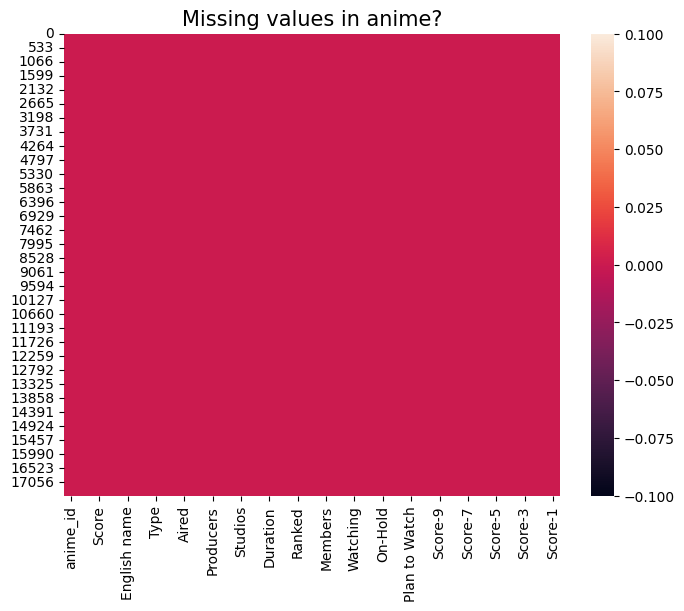

In [11]:
plt.figure(figsize=(8,6))
sns.heatmap(anime_info.isnull())
plt.title("Missing values in anime?", fontsize = 15)
plt.show()

### Visualization

In [10]:
edacol = ['anime_id', 'Name','English name', 'Score', 'Genres', 'Type', 'Aired', 'Premiered','Rating','Source','Episodes','Dropped'] 
eda = anime_info[edacol]
eda.set_index('anime_id',inplace=True)

#### Top 5 animes based on Score/Rating

In [11]:
anime_info.sort_values('Score',ascending=False).head(5)

,anime_id,Name,Score,Genres,English name,Japanese name,Type,Episodes,Aired,Premiered,Producers,Licensors,Studios,Source,Duration,Rating,Ranked,Popularity,Members,Favorites,Watching,Completed,On-Hold,Dropped,Plan to Watch,Score-10,Score-9,Score-8,Score-7,Score-6,Score-5,Score-4,Score-3,Score-2,Score-1
3971,5114,Fullmetal Alchemist: Brotherhood,9.19,"Action, Military, Adventure, Comedy, Drama, Ma...",Fullmetal Alchemist:Brotherhood,鋼の錬金術師 FULLMETAL ALCHEMIST,TV,64,"Apr 5, 2009 to Jul 4, 2010",Spring 2009,"Aniplex, Square Enix, Mainichi Broadcasting Sy...","Funimation, Aniplex of America",Bones,Manga,24 min. per ep.,R - 17+ (violence & profanity),1.0,3,2248456,183914,171871,1644938,75728,32456,323463,714811.0,401507.0,199160.0,70045.0,20210.0,9308.0,3222.0,1536.0,2162.0,16806.0
15926,40028,Shingeki no Kyojin: The Final Season,9.17,"Action, Military, Mystery, Super Power, Drama,...",Attack on Titan Final Season,進撃の巨人 The Final Season,TV,16,"Dec 7, 2020 to ?",Winter 2021,"Production I.G, Dentsu, Mainichi Broadcasting ...",Funimation,MAPPA,Manga,23 min. per ep.,R - 17+ (violence & profanity),2.0,119,733260,44862,566239,553,6658,2090,157720,173154.0,63756.0,26016.0,8793.0,2674.0,1336.0,588.0,382.0,514.0,11061.0
5683,9253,Steins;Gate,9.11,"Thriller, Sci-Fi",Steins;Gate,STEINS;GATE,TV,24,"Apr 6, 2011 to Sep 14, 2011",Spring 2011,"Frontier Works, Media Factory, Movic, AT-X, Ka...",Funimation,White Fox,Visual novel,24 min. per ep.,PG-13 - Teens 13 or older,3.0,9,1771162,148452,114349,1134756,60926,35600,425531,468504.0,275960.0,140914.0,57740.0,21375.0,11126.0,5061.0,2292.0,1678.0,5255.0
9913,28977,Gintama°,9.10,"Action, Comedy, Historical, Parody, Samurai, S...",Gintama Season 4,銀魂°,TV,51,"Apr 8, 2015 to Mar 30, 2016",Spring 2015,"TV Tokyo, Aniplex, Dentsu","Funimation, Crunchyroll",Bandai Namco Pictures,Manga,24 min. per ep.,PG-13 - Teens 13 or older,5.0,329,404121,11868,48011,167130,16612,11472,160896,78918.0,37902.0,21360.0,10215.0,3898.0,2311.0,952.0,648.0,1100.0,4508.0
14963,38524,Shingeki no Kyojin Season 3 Part 2,9.10,"Action, Drama, Fantasy, Military, Mystery, Sho...",Attack on Titan Season 3 Part 2,進撃の巨人 Season3 Part.2,TV,10,"Apr 29, 2019 to Jul 1, 2019",Spring 2019,"Production I.G, Dentsu, Mainichi Broadcasting ...",Funimation,Wit Studio,Manga,23 min. per ep.,R - 17+ (violence & profanity),4.0,63,1073626,40985,54607,906824,5533,3099,103563,327290.0,239451.0,110481.0,33662.0,8365.0,2974.0,1108.0,550.0,385.0,4169.0


In [12]:
eda

,Name,English name,Score,Genres,Type,Aired,Premiered,Rating,Source,Episodes,Dropped
anime_id,,,,,,,,,,,
1,Cowboy Bebop,Cowboy Bebop,8.78,"Action, Adventure, Comedy, Drama, Sci-Fi, Space",TV,"Apr 3, 1998 to Apr 24, 1999",Spring 1998,R - 17+ (violence & profanity),Original,26,26678
5,Cowboy Bebop: Tengoku no Tobira,Cowboy Bebop:The Movie,8.39,"Action, Drama, Mystery, Sci-Fi, Space",Movie,"Sep 1, 2001",Unknown,R - 17+ (violence & profanity),Original,1,770
6,Trigun,Trigun,8.24,"Action, Sci-Fi, Adventure, Comedy, Drama, Shounen",TV,"Apr 1, 1998 to Sep 30, 1998",Spring 1998,PG-13 - Teens 13 or older,Manga,26,13925
7,Witch Hunter Robin,Witch Hunter Robin,7.27,"Action, Mystery, Police, Supernatural, Drama, ...",TV,"Jul 2, 2002 to Dec 24, 2002",Summer 2002,PG-13 - Teens 13 or older,Original,26,5378
8,Bouken Ou Beet,Beet the Vandel Buster,6.98,"Adventure, Fantasy, Shounen, Supernatural",TV,"Sep 30, 2004 to Sep 29, 2005",Fall 2004,PG - Children,Manga,52,1108
...,...,...,...,...,...,...,...,...,...,...,...
48481,Daomu Biji Zhi Qinling Shen Shu,Unknown,0.00,"Adventure, Mystery, Supernatural",ONA,"Apr 4, 2021 to ?",Unknown,Unknown,Novel,Unknown,0
48483,Mieruko-chan,Unknown,0.00,"Comedy, Horror, Supernatural",TV,2021 to ?,Unknown,Unknown,Manga,Unknown,0
48488,Higurashi no Naku Koro ni Sotsu,Higurashi:When They Cry – SOTSU,0.00,"Mystery, Dementia, Horror, Psychological, Supe...",TV,"Jul, 2021 to ?",Summer 2021,R - 17+ (violence & profanity),Visual novel,Unknown,0


In [13]:
labels = eda['Type'].value_counts().index
values = eda['Type'].value_counts().values
colors = ["EE82EE","87CEEB","7FFFD4","00FF7F","C71585"]

fig = px.pie(
    names=labels, 
    values=values,
    width=800,
    height=600
)

fig.update_traces(marker_colors=colors,
                  marker=dict(colors=colors), 
                  marker_line=dict(color='white', width=2)
)
fig.update_layout(
    title_text="Medium of Streaming",
    title_x=0.5,
    font=dict(size=20),
    legend_font_size=20
)
fig.show()

* 28.4% of the anime's were aired on TV followed by 22.2% through OVA
* 17.3% of anime's are streamed as Movie which is greater than Special(12.6%) and ONA(10.9%)

In [14]:
labels = eda['Source'].value_counts().index
values = eda['Source'].value_counts().values
colors = ['gold', 'mediumturquoise', 'darkorange', 'lightgreen']
fig = go.Figure(
    data=[
        go.Pie(
        labels=labels,
        values=values)
        ],
        layout=go.Layout(height=600, width=800)
)
fig.update_traces(
    hoverinfo='label+percent', 
    textinfo='value', 
    textfont_size=20,
    marker=dict(colors=colors, line=dict(color='white', width=2)))

fig.update_layout(
    title={
        'text': "Sources of Engagement",
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

fig.show()

Insights: The above pie chart gives a count of sources of engagement of anime

Top 10 Anime based on popularity in different source (eg Original,Manga,etc)

In [15]:
sour = anime_info.sort_values(by='Popularity').groupby('Source')[['Name', 'Popularity']]
figs = []
for i in eda['Source'].value_counts().index:
    bar = sour.get_group(i)
    bar.set_index('Name', inplace=True)
    
    # Создаем график для текущего источника
    fig = go.Figure()
    fig.add_trace(go.Bar(
        y=bar.head(10).index,
        x=bar.head(10)['Popularity'],
        orientation='h',
        marker=dict(color='lightseagreen'),
    ))
    
    fig.update_layout(
        title=f'Source: {i}',
        xaxis_title='Popularity',
        yaxis_title='Name',
        showlegend=False,
        width=1400,
        height=600
    )
    
    figs.append(fig)

# Отображаем все графики
for fig in figs:
    fig.show()

Top 10 anime based on popularity in different Types

In [16]:
sour = anime_info.sort_values(by='Popularity').groupby('Type')[['Name', 'Popularity']]
figs = []
for i in eda['Type'].value_counts().index:
    bar = sour.get_group(i)
    bar.set_index('Name', inplace=True)
    
    # Создаем график для текущего источника
    fig = go.Figure()
    fig.add_trace(go.Bar(
        y=bar.head(10).index,
        x=bar.head(10)['Popularity'],
        orientation='h',
        marker=dict(color='lightseagreen'),
    ))
    
    fig.update_layout(
        title=f'Source: {i}',
        xaxis_title='Popularity',
        yaxis_title='Name',
        showlegend=False,
        width=1400,
        height=600
    )
    
    figs.append(fig)

# Отображаем все графики
for fig in figs:
    fig.show()

We are taking a sample of 50,000 user ratings as processing on the full dataset is memory consuming

In [17]:
df = anime_list.iloc[:18522589,:]
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18522589 entries, 0 to 18522588
Data columns (total 5 columns):
 #   Column            Dtype
---  ------            -----
 0   user_id           int64
 1   anime_id          int64
 2   rating            int64
 3   watching_status   int64
 4   watched_episodes  int64
dtypes: int64(5)
memory usage: 706.6 MB


In [18]:
anime_fulldata=pd.merge(anime_info,df,on='anime_id')

In [19]:
anime_ratingCount = (anime_fulldata.groupby(by = ['Name'])['rating'].count().reset_index()[['Name', 'rating']])

I'm sensing the top anime's based on their rating counts provided by the user id's

In [20]:
top10_animerating = anime_ratingCount[['Name', 'rating']].sort_values(by='rating', ascending=False).head(10)

# Создаем график
fig = px.bar(
    top10_animerating,
    x='Name',
    y='rating',
    color='rating',
    color_continuous_scale='Cividis',
    title='Top 10 Anime based on rating counts',
    labels={'Name': 'Anime', 'rating': 'User Rating count'},
    width=800,
    height=600
)

fig.update_layout(
    xaxis=dict(tickangle=40, tickfont=dict(size=11)),
    title_font=dict(size=22),
    xaxis_title_font=dict(size=20),
    yaxis_title_font=dict(size=20)
)

fig.show()

Here are some animes which were dropped by many user's

In [21]:
# Отбираем топ-10 аниме по количеству "Dropped"
drop = eda[['Name', 'Dropped']].sort_values(by='Dropped', ascending=False).head(10)

# Создаем график
fig = px.bar(
    drop,
    x='Name',
    y='Dropped',
    title='Top 10 Anime based on Dropped count',
    labels={'Name': 'Anime', 'Dropped': 'Dropped count'},
    width=800,
    height=600
)

fig.update_layout(
    xaxis=dict(tickangle=40, tickfont=dict(size=11)),
    title_font=dict(size=22),
    xaxis_title_font=dict(size=20),
    yaxis_title_font=dict(size=20)
)

fig.show()

Here we have categorized animes according to Rating and displayed there count

In [22]:
labels = eda['Rating'].value_counts().index
values = eda['Rating'].value_counts().values

rating_counts = eda['Rating'].value_counts()
colors = ["#EE82EE","#87CEEB","#7FFFD4","#00FF7F","#C71585", "blue", "orange"]

fig = px.pie(
    names=rating_counts.index,
    values=rating_counts.values,
    color_discrete_sequence=colors,
    title="Rating based Anime"
)

fig.update_traces(
    hoverinfo='label+percent',
    textinfo='value',
    textfont_size=20,
    marker=dict(line=dict(color='white', width=2))
)

fig.update_layout(
    title={
        'text': "Rating based Anime",
        'y': 0.9,
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    height=600,
    width=800
)

fig.show()

Here we have listed Top 10 animes based on their No. of Episodes

In [23]:
eda['Episodes'] = eda['Episodes'].replace('Unknown', 0).astype(str).astype(int)
epi = eda[['Name', 'Episodes']].sort_values(by='Episodes', ascending=False).head(10)

fig = px.bar(
    epi,
    x='Name',
    y='Episodes',
    color='Episodes',
    color_continuous_scale='Cividis',
    title='Top 10 Anime based on Episode count',
    labels={'Name': 'Anime', 'Episodes': 'Episode count'}
)

fig.update_layout(
    xaxis=dict(tickangle=40, tickfont=dict(size=11)),
    title_font=dict(size=22),
    xaxis_title_font=dict(size=20),
    yaxis_title_font=dict(size=20),
    width=800,
    height=600
)
fig.show()

/tmp/ipykernel_797/608273706.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Here we have categorized animes based on their Production Studio and displayed there count

In [24]:
anime_info['Studios'] = anime_info['Studios'].replace('Unknown', 0)
stu = anime_info['Studios'].value_counts().reset_index()
stu.columns = ["Studio", "No of animes"] 
stu = stu.drop(0).head(10)
stu = stu.query("Studio != 0").head(10)

In [25]:
colors = ['f72585','b5179e','7209b7','560bad','480ca8','3a0ca3','3f37c9','4361ee','4895ef','4cc9f0']

fig = go.Figure(data=[
    go.Pie(
        labels=stu["Studio"],      
        values=stu["No of animes"],
        hole=.4,                 
        hoverinfo="label+percent",
        textinfo="value",     
        textfont_size=20,        
        marker=dict(colors=colors,
                   line=dict(color="white", width=2))  #
    )
])

fig.update_layout(
    height=600,
    width=800,
    title={
        'text': "Production Distribution by Anime Studios",
        'y': 0.9,
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    }
)

# Отображение графика
fig.show()

Here we have displayed the Genre Cloud of Animes

(np.float64(-0.5), np.float64(799.5), np.float64(399.5), np.float64(-0.5))

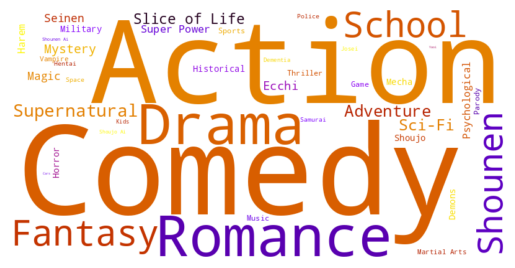

In [26]:
nonull_anime=anime_fulldata.copy()
nonull_anime.dropna(inplace=True)
from collections import defaultdict

all_genres = defaultdict(int)

for genres in nonull_anime['Genres']:
    for genre in genres.split(','):
        all_genres[genre.strip()] += 1
        
from wordcloud import WordCloud

genres_cloud = WordCloud(width=800, height=400, background_color='white', colormap='gnuplot').generate_from_frequencies(all_genres)
plt.imshow(genres_cloud, interpolation='bilinear')
plt.axis('off')

In [ ]:
# clean RAM
del nonull_anime
del anime_info
del anime_synop
del rating_complete
del watching_status
del eda
del df

## Collaborative Filtering

### we will make recommendations based on collaborative filters

* predicting what users will like based on their similarity to other users.
* Advantages: capable of accurately recommending complex items such as movies without requiring an “understanding” of the item itself.
* many have been used in measuring (user similarity or item similarity) in recommender systems.
* Task 1: finding similar animes
* Task 2: finding similar users
* Task 3: Recommending Animes for a random user

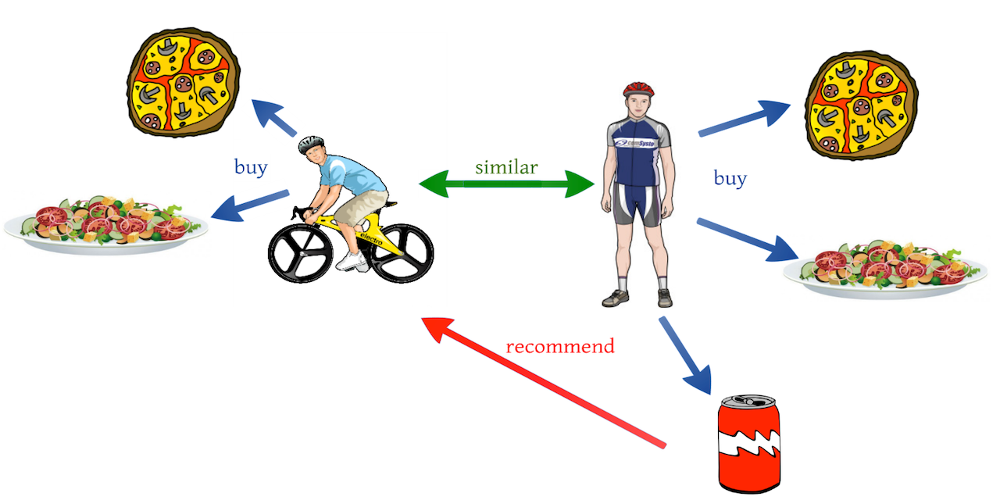

In [1]:
import pandas as pd
import numpy as np

In [2]:
# read dataset
anime_list = pd.read_csv('data/animelist.csv')
anime_list.head(4)

,user_id,anime_id,rating,watching_status,watched_episodes
0,0,67,9,1,1
1,0,6702,7,1,4
2,0,242,10,1,4
3,0,4898,0,1,1


In [3]:
import tensorflow as tf

# Получаем список физических устройств
devices = tf.config.list_physical_devices('GPU')

if devices:
    print("Доступны GPU:", len(devices))
    print("Имя первого GPU:", devices[0].name)
else:
    print("GPU не обнаружено.")

2025-05-07 02:52:22.260679: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-05-07 02:52:22.545527: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1746575542.643221     576 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1746575542.671375     576 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1746575542.896642     576 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking 

Доступны GPU: 1
Имя первого GPU: /physical_device:GPU:0


Since we have quite a large number of lines with user ratings of 1/2 anime, we need to exclude them from the sample. Let's take the value of 400+ rated titles

In [4]:
# User should rate atleast 400 animies
n_anime_list = anime_list['user_id'].value_counts()
anime_list = anime_list[anime_list['user_id'].isin(n_anime_list[n_anime_list >= 400].index)].copy()
len(anime_list)

71418114

let's change the values ​​to normalize the data

In [5]:
min_rating = min(anime_list['rating'])
max_rating = max(anime_list['rating'])
anime_list['rating'] = anime_list["rating"].apply(lambda x: (x - min_rating) / (max_rating - min_rating)).values.astype(np.float64)

AvgRating = np.mean(anime_list['rating'])
print('Avg', AvgRating)

Avg 0.4047793589172634


Removing Duplicated Rows

In [6]:
duplicates = anime_list.duplicated()

if duplicates.sum() > 0:
    print('> {} duplicates'.format(duplicates.sum()))
    anime_list = anime_list[~duplicates]

print('> {} duplicates'.format(anime_list.duplicated().sum()))

> 1 duplicates
> 0 duplicates


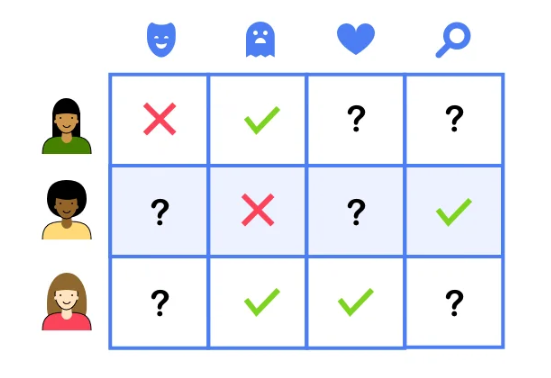

In [7]:
g = anime_list.groupby('user_id')['rating'].count()
top_users = g.dropna().sort_values(ascending=False)[:20]
top_r = anime_list.join(top_users, rsuffix='_r', how='inner', on='user_id')

g = anime_list.groupby('anime_id')['rating'].count()
top_animes = g.dropna().sort_values(ascending=False)[:20]
top_r = top_r.join(top_animes, rsuffix='_r', how='inner', on='anime_id')

pd.crosstab(top_r.user_id, top_r.anime_id, top_r.rating, aggfunc=np.sum)

/tmp/ipykernel_576/3906098663.py:9: FutureWarning: The provided callable <function sum at 0x7f75d8d69a80> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  pd.crosstab(top_r.user_id, top_r.anime_id, top_r.rating, aggfunc=np.sum)


anime_id,226,1535,1575,2001,2167,4224,5081,5114,6547,6746,9253,9989,10620,11757,15809,16498,19815,20507,22319,30276
user_id,,,,,,,,,,,,,,,,,,,,
20807,1.0,1.0,1.0,1.0,0.8,1.0,0.9,1.0,1.0,1.0,1.0,0.9,1.0,1.0,0.8,1.0,1.0,1.0,1.0,1.0
50485,0.0,0.6,1.0,1.0,0.9,1.0,1.0,1.0,1.0,0.9,1.0,0.9,0.6,1.0,1.0,0.9,1.0,1.0,1.0,0.8
63900,0.7,0.0,0.0,0.0,0.0,0.0,0.0,0.9,0.0,0.0,0.0,0.8,0.0,0.0,0.0,0.8,0.0,0.8,0.8,0.8
68042,0.8,1.0,0.9,1.0,0.7,0.9,1.0,0.9,0.7,0.8,0.9,0.8,0.4,0.4,0.6,0.9,0.3,0.2,0.5,0.9
85472,0.7,0.0,0.0,1.0,0.9,0.9,0.0,0.0,1.0,0.0,0.8,0.0,0.8,0.9,0.8,0.8,0.7,0.7,0.7,0.9
92529,0.9,0.9,1.0,1.0,0.0,0.8,0.0,0.9,0.9,0.0,1.0,0.0,0.8,0.9,0.8,0.9,0.9,0.8,0.8,1.0
122341,0.2,0.3,0.2,0.7,0.4,0.3,0.3,0.8,0.5,0.6,0.7,0.3,0.2,0.1,0.3,0.1,0.4,0.4,0.2,0.6
131988,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
140590,0.3,0.6,0.5,0.8,0.6,0.8,0.8,0.9,0.5,0.8,0.9,0.7,0.3,0.4,0.6,0.5,0.7,0.7,0.5,0.7


Encoding categorical data

In [8]:
user_ids = anime_list["user_id"].unique().tolist()
user2user_encoded = {x: i for i, x in enumerate(user_ids)}
user_encoded2user = {i: x for i, x in enumerate(user_ids)}
anime_list["user"] = anime_list["user_id"].map(user2user_encoded)
n_users = len(user2user_encoded)

anime_ids = anime_list["anime_id"].unique().tolist()
anime2anime_encoded = {x: i for i, x in enumerate(anime_ids)}
anime_encoded2anime = {i: x for i, x in enumerate(anime_ids)}
anime_list["anime"] = anime_list["anime_id"].map(anime2anime_encoded)
n_animes = len(anime2anime_encoded)

print("Num of users: {}, Num of animes: {}".format(n_users, n_animes))
print("Min rating: {}, Max rating: {}".format(min(anime_list['rating']), max(anime_list['rating'])))

Num of users: 91641, Num of animes: 17560
Min rating: 0.0, Max rating: 1.0


In [9]:
rating_df = anime_list.sample(frac=1, random_state=73)
del anime_list
X = rating_df[['user', 'anime']].values
y = rating_df["rating"]

In [10]:
test_set_size = 10000 #10k for test set
train_indices = rating_df.shape[0] - test_set_size 

X_train, X_test, y_train, y_test = (
    X[:train_indices],
    X[train_indices:],
    y[:train_indices],
    y[train_indices:],
)

print('> Train set ratings: {}'.format(len(y_train)))
print('> Test set ratings: {}'.format(len(y_test)))

> Train set ratings: 71408113
> Test set ratings: 10000


In [11]:
X_train_array = [X_train[:, 0], X_train[:, 1]]
X_test_array = [X_test[:, 0], X_test[:, 1]]

### Model Building

In [13]:
from tensorflow.keras import layers
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

In [14]:
# Embedding layers
from tensorflow.keras.layers import Add, Activation, Lambda, BatchNormalization, Concatenate, Dropout, Input, Embedding, Dot, Reshape, Dense, Flatten

def RecommenderNet():
    embedding_size = 128
    
    user = Input(name = 'user', shape = [1])
    user_embedding = Embedding(name = 'user_embedding',
                       input_dim = n_users, 
                       output_dim = embedding_size)(user)
    
    anime = Input(name = 'anime', shape = [1])
    anime_embedding = Embedding(name = 'anime_embedding',
                       input_dim = n_animes, 
                       output_dim = embedding_size)(anime)
    
    #x = Concatenate()([user_embedding, anime_embedding])
    x = Dot(name = 'dot_product', normalize = True, axes = 2)([user_embedding, anime_embedding])
    x = Flatten()(x)
        
    x = Dense(1, kernel_initializer='he_normal')(x)
    x = BatchNormalization()(x)
    x = Activation("sigmoid")(x)
    
    model = Model(inputs=[user, anime], outputs=x)
    model.compile(loss='binary_crossentropy', metrics=["mae", "mse"], optimizer='Adam')
    
    return model

if TPU_INIT:    
    with tpu_strategy.scope():
        model = RecommenderNet()
else:
    model = RecommenderNet()

model.summary()

I0000 00:00:1746575595.250527     576 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 9517 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 4070 SUPER, pci bus id: 0000:01:00.0, compute capability: 8.9


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ user (InputLayer)   │ (None, 1)         │          0 │ -                 │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ anime (InputLayer)  │ (None, 1)         │          0 │ -                 │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ user_embedding      │ (None, 1, 128)    │ 11,730,048 │ user[0][0]        │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ anime_embedding     │ (None, 1, 128)    │  2,247,680 │ anime[0][0]       │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dot_product (Dot)   │ (None, 1, 1)      │          0 │ user_embedding[0… │
│                     │                   │            │ anime_embedding[… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ flatten (Flatten)   │ (None, 1)         │          0 │ dot_product[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense (Dense)       │ (None, 1)         │          2 │ flatten[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 1)         │          4 │ dense[0][0]       │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation          │ (None, 1)         │          0 │ batch_normalizat… │
│ (Activation)        │                   │            │                   │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 13,977,734 (53.32 MB)

 Trainable params: 13,977,732 (53.32 MB)

 Non-trainable params: 2 (8.00 B)

In [15]:
# Callbacks
from tensorflow.keras.callbacks import Callback, ModelCheckpoint, LearningRateScheduler, TensorBoard, EarlyStopping, ReduceLROnPlateau

start_lr = 0.00001
min_lr = 0.00001
max_lr = 0.00005
batch_size = 10000

if TPU_INIT:
    max_lr = max_lr * tpu_strategy.num_replicas_in_sync
    batch_size = batch_size * tpu_strategy.num_replicas_in_sync

rampup_epochs = 5
sustain_epochs = 0
exp_decay = .8

def lrfn(epoch):
    if epoch < rampup_epochs:
        return (max_lr - start_lr)/rampup_epochs * epoch + start_lr
    elif epoch < rampup_epochs + sustain_epochs:
        return max_lr
    else:
        return (max_lr - min_lr) * exp_decay**(epoch-rampup_epochs-sustain_epochs) + min_lr


lr_callback = LearningRateScheduler(lambda epoch: lrfn(epoch), verbose=0)

checkpoint_filepath = './name.weights.h5'

model_checkpoints = ModelCheckpoint(filepath=checkpoint_filepath,
                                        save_weights_only=True,
                                        monitor='val_loss',
                                        mode='min',
                                        save_best_only=True)

early_stopping = EarlyStopping(patience = 3, monitor='val_loss', 
                               mode='min', restore_best_weights=True)

my_callbacks = [
    model_checkpoints,
    lr_callback,
    early_stopping,   
]

In [16]:
# Model training
history = model.fit(
    x=X_train_array,
    y=y_train,
    batch_size=batch_size,
    epochs=20,
    verbose=1,
    validation_data=(X_test_array, y_test),
    callbacks=my_callbacks
)

model.load_weights(checkpoint_filepath)

Epoch 1/20


I0000 00:00:1746575600.349606     930 service.cc:152] XLA service 0x7f7418017e80 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1746575600.349680     930 service.cc:160]   StreamExecutor device (0): NVIDIA GeForce RTX 4070 SUPER, Compute Capability 8.9
2025-05-07 02:53:20.386431: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1746575600.517932     930 cuda_dnn.cc:529] Loaded cuDNN version 90300


  51/7141 ━━━━━━━━━━━━━━━━━━━━ 21s 3ms/step - loss: 0.7949 - mae: 0.3841 - mse: 0.1975

I0000 00:00:1746575600.951674     930 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


7141/7141 ━━━━━━━━━━━━━━━━━━━━ 25s 3ms/step - loss: 0.7885 - mae: 0.3822 - mse: 0.1951 - val_loss: 0.7725 - val_mae: 0.3825 - val_mse: 0.1911 - learning_rate: 1.0000e-05
Epoch 2/20
7141/7141 ━━━━━━━━━━━━━━━━━━━━ 23s 3ms/step - loss: 0.7576 - mae: 0.3744 - mse: 0.1833 - val_loss: 0.7165 - val_mae: 0.3636 - val_mse: 0.1678 - learning_rate: 1.8000e-05
Epoch 3/20
7141/7141 ━━━━━━━━━━━━━━━━━━━━ 24s 3ms/step - loss: 0.6640 - mae: 0.3327 - mse: 0.1428 - val_loss: 0.5906 - val_mae: 0.2907 - val_mse: 0.1122 - learning_rate: 2.6000e-05
Epoch 4/20
7141/7141 ━━━━━━━━━━━━━━━━━━━━ 22s 3ms/step - loss: 0.5677 - mae: 0.2712 - mse: 0.1008 - val_loss: 0.5503 - val_mae: 0.2572 - val_mse: 0.0961 - learning_rate: 3.4000e-05
Epoch 5/20
7141/7141 ━━━━━━━━━━━━━━━━━━━━ 24s 3ms/step - loss: 0.5319 - mae: 0.2398 - mse: 0.0871 - val_loss: 0.5251 - val_mae: 0.2323 - val_mse: 0.0866 - learning_rate: 4.2000e-05
Epoch 6/20
7141/7141 ━━━━━━━━━━━━━━━━━━━━ 23s 3ms/step - loss: 0.5069 - mae: 0.2155 - mse: 0.0781 - val_lo

In [21]:
import plotly.graph_objects as go

# Создаем линии для train и test потерь
fig = go.Figure()

fig.add_trace(go.Scatter(y=history.history["loss"][0:-2], mode='lines', name='Train Loss'))
fig.add_trace(go.Scatter(y=history.history["val_loss"][0:-2], mode='lines', name='Test Loss'))

# Настраиваем заголовок и подписи осей
fig.update_layout(
    title_text='Model Loss',
    xaxis_title='Epoch',
    yaxis_title='Loss',
    width=800,      
    height=600
)

# Отображаем график
fig.show()

### Extracting weights from model

In [22]:
def extract_weights(name, model):
    weight_layer = model.get_layer(name)
    weights = weight_layer.get_weights()[0]
    weights = weights / np.linalg.norm(weights, axis = 1).reshape((-1, 1))
    return weights

anime_weights = extract_weights('anime_embedding', model)
user_weights = extract_weights('user_embedding', model)

anime meta data

In [24]:
df = pd.read_csv('data/anime.csv', low_memory=True)
df = df.replace("Unknown", np.nan)

In [25]:
# Fixing Names
def getAnimeName(anime_id):
    try:
        name = df[df.anime_id == anime_id].eng_version.values[0]
        if name is np.nan:
            name = df[df.anime_id == anime_id].Name.values[0]
    except:
        print('error')
    
    return name

df['anime_id'] = df['MAL_ID']
df["eng_version"] = df['English name']
df['eng_version'] = df.anime_id.apply(lambda x: getAnimeName(x))

df.sort_values(by=['Score'], 
               inplace=True,
               ascending=False, 
               kind='quicksort',
               na_position='last')

df = df[["anime_id", "eng_version", 
         "Score", "Genres", "Episodes", 
         "Type", "Premiered", "Members"]]

In [26]:
def getAnimeFrame(anime):
    if isinstance(anime, int):
        return df[df.anime_id == anime]
    if isinstance(anime, str):
        return df[df.eng_version == anime]

sypnopsis data

In [27]:
cols = ["MAL_ID", "Name", "Genres", "sypnopsis"]
sypnopsis_df = pd.read_csv('data/anime_with_synopsis.csv', usecols=cols)

def getSypnopsis(anime):
    if isinstance(anime, int):
        return sypnopsis_df[sypnopsis_df.MAL_ID == anime].sypnopsis.values[0]
    if isinstance(anime, str):
        return sypnopsis_df[sypnopsis_df.Name == anime].sypnopsis.values[0]

Task 1: Finding Similar Animes (Item Based Recommendation)

In [28]:
#pd.reset_option('all')
pd.set_option("max_colwidth", None)

def find_similar_animes(name, n=10, return_dist=False, neg=False):
    try:
        index = getAnimeFrame(name).anime_id.values[0]
        encoded_index = anime2anime_encoded.get(index)
        weights = anime_weights
        
        dists = np.dot(weights, weights[encoded_index])
        sorted_dists = np.argsort(dists)
        
        n = n + 1            
        
        if neg:
            closest = sorted_dists[:n]
        else:
            closest = sorted_dists[-n:]

        print('animes closest to {}'.format(name))

        if return_dist:
            return dists, closest
        
        rindex = df

        SimilarityArr = []

        for close in closest:
            decoded_id = anime_encoded2anime.get(close)
            sypnopsis = getSypnopsis(decoded_id)
            anime_frame = getAnimeFrame(decoded_id)
            
            anime_name = anime_frame.eng_version.values[0]
            genre = anime_frame.Genres.values[0]
            similarity = dists[close]
            SimilarityArr.append({"anime_id": decoded_id, "name": anime_name,
                                  "similarity": similarity,"genre": genre,
                                  'sypnopsis': sypnopsis})

        Frame = pd.DataFrame(SimilarityArr).sort_values(by="similarity", ascending=False)
        return Frame[Frame.anime_id != index].drop(['anime_id'], axis=1)

    except:
        print('{}!, Not Found in Anime list'.format(name))

#### anime test titles

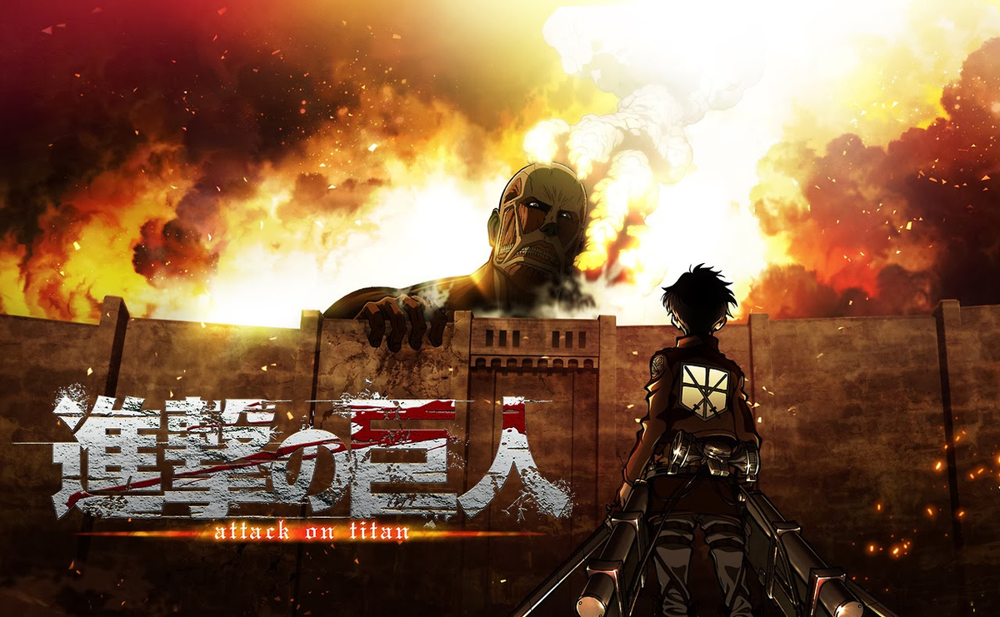

In [33]:
find_similar_animes('Attack on Titan', n=5, neg=False)

animes closest to Attack on Titan


,name,similarity,genre,sypnopsis
4,Death Note,0.858150,"Mystery, Police, Psychological, Supernatural, Thriller, Shounen","shinigami, as a god of death, can kill any person—provided they see their victim's face and write their victim's name in a notebook called a Death Note. One day, Ryuk, bored by the shinigami lifestyle and interested in seeing how a human would use a Death Note, drops one into the human realm. High school student and prodigy Light Yagami stumbles upon the Death Note and—since he deplores the state of the world—tests the deadly notebook by writing a criminal's name in it. When the criminal dies immediately following his experiment with the Death Note, Light is greatly surprised and quickly recognizes how devastating the power that has fallen into his hands could be. With this divine capability, Light decides to extinguish all criminals in order to build a new world where crime does not exist and people worship him as a god. Police, however, quickly discover that a serial killer is targeting criminals and, consequently, try to apprehend the culprit. To do this, the Japanese investigators count on the assistance of the best detective in the world: a young and eccentric man known only by the name of L."
3,Tokyo Ghoul,0.855891,"Action, Mystery, Horror, Psychological, Supernatural, Drama, Seinen","Tokyo has become a cruel and merciless city—a place where vicious creatures called ""ghouls"" exist alongside humans. The citizens of this once great metropolis live in constant fear of these bloodthirsty savages and their thirst for human flesh. However, the greatest threat these ghouls pose is their dangerous ability to masquerade as humans and blend in with society. Based on the best-selling supernatural horror manga by Sui Ishida, Tokyo Ghoul follows Ken Kaneki, a shy, bookish college student, who is instantly drawn to Rize Kamishiro, an avid reader like himself. However, Rize is not exactly who she seems, and this unfortunate meeting pushes Kaneki into the dark depths of the ghouls' inhuman world. In a twist of fate, Kaneki is saved by the enigmatic waitress Touka Kirishima, and thus begins his new, secret life as a half-ghoul/half-human who must find a way to integrate into both societies."
2,One Punch Man,0.815056,"Action, Sci-Fi, Comedy, Parody, Super Power, Supernatural","The seemingly ordinary and unimpressive Saitama has a rather unique hobby: being a hero. In order to pursue his childhood dream, he trained relentlessly for three years—and lost all of his hair in the process. Now, Saitama is incredibly powerful, so much so that no enemy is able to defeat him in battle. In fact, all it takes to defeat evildoers with just one punch has led to an unexpected problem—he is no longer able to enjoy the thrill of battling and has become quite bored. This all changes with the arrival of Genos, a 19-year-old cyborg, who wishes to be Saitama's disciple after seeing what he is capable of. Genos proposes that the two join the Hero Association in order to become certified heroes that will be recognized for their positive contributions to society, and Saitama, shocked that no one knows who he is, quickly agrees. And thus begins the story of One Punch Man , an action-comedy that follows an eccentric individual who longs to fight strong enemies that can hopefully give him the excitement he once felt and just maybe, he'll become popular in the process."
1,Sword Art Online,0.803707,"Action, Game, Adventure, Romance, Fantasy","In the year 2022, virtual reality has progressed by leaps and bounds, and a massive online role-playing game called Sword Art Online (SAO) is launched. With the aid of ""NerveGear"" technology, players can control their avatars within the game using nothing but their own thoughts. Kazuto Kirigaya, nicknamed ""Kirito,"" is among the lucky few enthusiasts who get their hands on the first shipment of the game. He logs in to find himself, with ten-thousand others, in the scenic and elaborate world of Aincrad, o

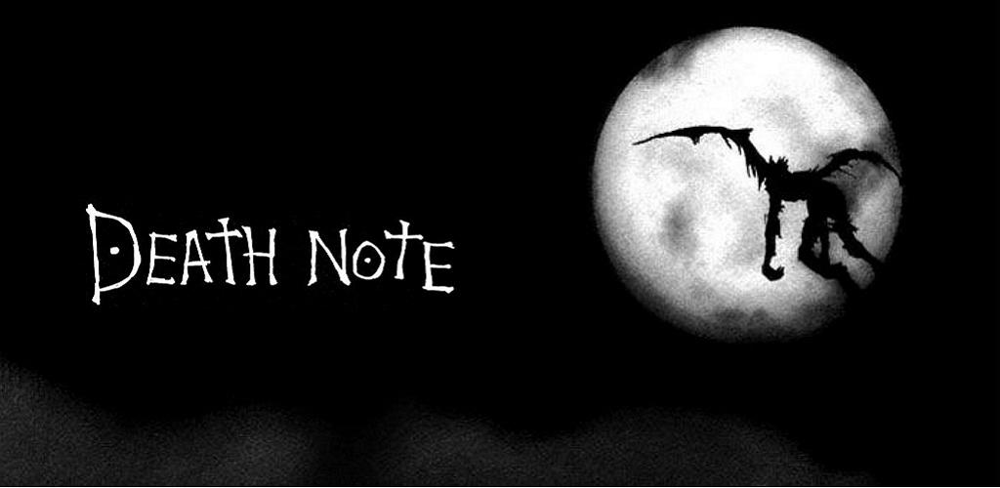

In [ ]:
find_similar_animes('Death Note', n=5, neg=False)

animes closest to Death Note


,name,similarity,genre,sypnopsis
4,Attack on Titan,0.858150,"Action, Military, Mystery, Super Power, Drama, Fantasy, Shounen","Centuries ago, mankind was slaughtered to near extinction by monstrous humanoid creatures called titans, forcing humans to hide in fear behind enormous concentric walls. What makes these giants truly terrifying is that their taste for human flesh is not born out of hunger but what appears to be out of pleasure. To ensure their survival, the remnants of humanity began living within defensive barriers, resulting in one hundred years without a single titan encounter. However, that fragile calm is soon shattered when a colossal titan manages to breach the supposedly impregnable outer wall, reigniting the fight for survival against the man-eating abominations. After witnessing a horrific personal loss at the hands of the invading creatures, Eren Yeager dedicates his life to their eradication by enlisting into the Survey Corps, an elite military unit that combats the merciless humanoids outside the protection of the walls. Based on Hajime Isayama's award-winning manga, Shingeki no Kyojin follows Eren, along with his adopted sister Mikasa Ackerman and his childhood friend Armin Arlert, as they join the brutal war against the titans and race to discover a way of defeating them before the last walls are breached."
3,Code Geass:Lelouch of the Rebellion R2,0.799681,"Action, Military, Sci-Fi, Super Power, Drama, Mecha","One year has passed since the Black Rebellion, a failed uprising against the Holy Britannian Empire led by the masked vigilante Zero, who is now missing. At a loss without their revolutionary leader, Area 11's resistance group—the Black Knights—find themselves too powerless to combat the brutality inflicted upon the Elevens by Britannia, which has increased significantly in order to crush any hope of a future revolt. Lelouch Lamperouge, having lost all memory of his double life, is living peacefully alongside his friends as a high school student at Ashford Academy. His former partner C.C., unable to accept this turn of events, takes it upon herself to remind him of his past purpose, hoping that the mastermind Zero will rise once again to finish what he started, in this thrilling conclusion to the series."
2,Code Geass:Lelouch of the Rebellion,0.798240,"Action, Military, Sci-Fi, Super Power, Drama, Mecha, School","In the year 2010, the Holy Empire of Britannia is establishing itself as a dominant military nation, starting with the conquest of Japan. Renamed to Area 11 after its swift defeat, Japan has seen significant resistance against these tyrants in an attempt to regain independence. Lelouch Lamperouge, a Britannian student, unfortunately finds himself caught in a crossfire between the Britannian and the Area 11 rebel armed forces. He is able to escape, however, thanks to the timely appearance of a mysterious girl named C.C., who bestows upon him Geass, the ""Power of Kings."" Realizing the vast potential of his newfound ""power of absolute obedience,"" Lelouch embarks upon a perilous journey as the masked vigilante known as Zero, leading a merciless onslaught against Britannia in order to get revenge once and for all."
1,Naruto,0.783057,"Action, Adventure, Comedy, Super Power, Martial Arts, Shounen","oments prior to Naruto Uzumaki's birth, a huge demon known as the Kyuubi, the Nine-Tailed Fox, attacked Konohagakure, the Hidden Leaf Village, and wreaked havoc. In order to put an end to the Kyuubi's rampage, the leader of the village, the Fourth Hokage, sacrificed his life and sealed the monstrous beast inside the newborn Naruto. Now, Naruto is a hyperactive and knuckle-headed ninja still living in Konohagakure. Shunned because of the Kyuubi inside him, Naruto struggles to find his place in the village, while his burning desire to become the Hokage of Konohagakure leads him not only to some great new friends, but also some deadly foes."
0,Elfen Lied,0.779900,"Action, Horror, Psychological, Supern

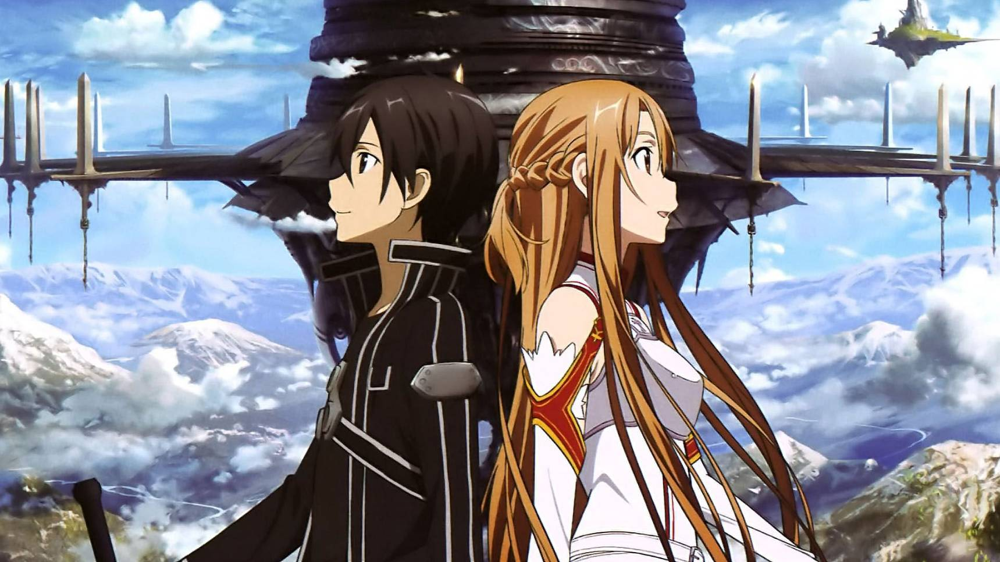

In [36]:
find_similar_animes('Sword Art Online', n=5, neg=False)

animes closest to Sword Art Online


,name,similarity,genre,sypnopsis
4,Sword Art Online II,0.889637,"Action, Game, Adventure, Romance, Fantasy","ar after escaping Sword Art Online, Kazuto Kirigaya has been settling back into the real world. However, his peace is short-lived as a new incident occurs in a game called Gun Gale Online, where a player by the name of Death Gun appears to be killing people in the real world by shooting them in-game. Approached by officials to assist in investigating the murders, Kazuto assumes his persona of Kirito once again and logs into Gun Gale Online, intent on stopping the killer. Once inside, Kirito meets Sinon, a highly skilled sniper afflicted by a traumatic past. She is soon dragged in his chase after Death Gun, and together they enter the Bullet of Bullets, a tournament where their target is sure to appear. Uncertain of Death Gun's real powers, Kirito and Sinon race to stop him before he has the chance to claim another life. Not everything goes smoothly, however, as scars from the past impede their progress. In a high-stakes game where the next victim could easily be one of them, Kirito puts his life on the line in the virtual world once more."
3,"No Game, No Life",0.864806,"Game, Adventure, Comedy, Supernatural, Ecchi, Fantasy","No Game No Life is a surreal comedy that follows Sora and Shiro, shut-in NEET siblings and the online gamer duo behind the legendary username ""Blank."" They view the real world as just another lousy game; however, a strange e-mail challenging them to a chess match changes everything—the brother and sister are plunged into an otherworldly realm where they meet Tet, the God of Games. The mysterious god welcomes Sora and Shiro to Disboard, a world where all forms of conflict—from petty squabbles to the fate of whole countries—are settled not through war, but by way of high-stake games. This system works thanks to a fundamental rule wherein each party must wager something they deem to be of equal value to the other party's wager. In this strange land where the very idea of humanity is reduced to child's play, the indifferent genius gamer duo of Sora and Shiro have finally found a real reason to keep playing games: to unite the sixteen races of Disboard, defeat Tet, and become the gods of this new, gaming-is-everything world."
2,Attack on Titan,0.803707,"Action, Military, Mystery, Super Power, Drama, Fantasy, Shounen","Centuries ago, mankind was slaughtered to near extinction by monstrous humanoid creatures called titans, forcing humans to hide in fear behind enormous concentric walls. What makes these giants truly terrifying is that their taste for human flesh is not born out of hunger but what appears to be out of pleasure. To ensure their survival, the remnants of humanity began living within defensive barriers, resulting in one hundred years without a single titan encounter. However, that fragile calm is soon shattered when a colossal titan manages to breach the supposedly impregnable outer wall, reigniting the fight for survival against the man-eating abominations. After witnessing a horrific personal loss at the hands of the invading creatures, Eren Yeager dedicates his life to their eradication by enlisting into the Survey Corps, an elite military unit that combats the merciless humanoids outside the protection of the walls. Based on Hajime Isayama's award-winning manga, Shingeki no Kyojin follows Eren, along with his adopted sister Mikasa Ackerman and his childhood friend Armin Arlert, as they join the brutal war against the titans and race to discover a way of defeating them before the last walls are breached."
1,Tokyo Ghoul,0.787346,"Action, Mystery, Horror, Psychological, Supernatural, Drama, Seinen","Tokyo has become a cruel and merciless city—a place where vicious creatures called ""ghouls"" exist alongside humans. The citizens of this once great metropolis live in constant fear of these bloodthirsty savages and their thirst for human flesh. However, the greatest threat these ghouls pose is

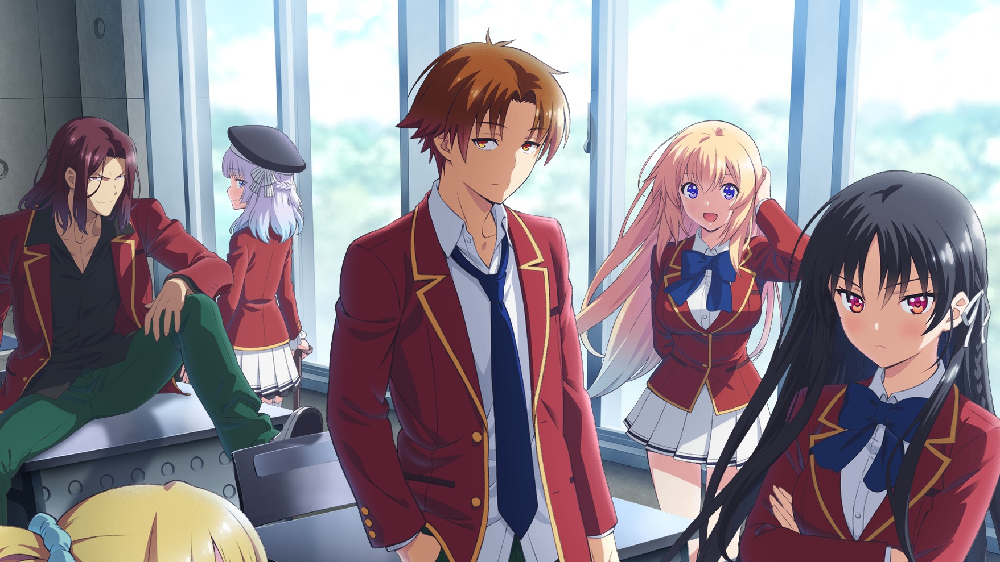

In [37]:
find_similar_animes('Classroom of the Elite', n=5, neg=False)

animes closest to Classroom of the Elite


,name,similarity,genre,sypnopsis
4,Akashic Records of Bastard Magic Instructor,0.827333,"Action, Magic, Fantasy, School","The Alzano Empire is home to one of the most distinguished magic schools in the world: the Alzano Imperial Magic Academy. Here, ambitious young students undergo training to become competent magicians. Sistine Fibel—a stern noble girl—and her bright-eyed best friend Rumia Tingel attend the Academy, determined to cultivate their magical skills. However, their world is thrown for a loop when their favorite teacher suddenly retires and the enigmatic Glenn Radars replaces him. His lazy and indifferent attitude toward life and magic quickly puts him at odds with his class. What's more, nefarious forces hidden within the empire's walls start to become active, and Sistine, Rumia, and Glenn find themselves caught up in their schemes. Rokudenashi Majutsu Koushi to Akashic Records follows Sistine, who is captivated by a mysterious floating Sky Castle; Rumia, who is haunted by a troubled past; and Glenn, who may be more than meets the eye. Though completely different on the surface, they are inexplicably bound together by a thread of fate."
3,Masamune-kun's Revenge,0.813073,"Comedy, Harem, Romance, School, Shounen","hen Masamune Makabe was a child, he was rejected by a rich, beautiful girl named Aki Adagaki, who gave him the nickname ''Piggy'' for being overweight. Devastated, Masamune put great effort into working out to improve his appearance. Now a handsome yet narcissistic high school student, Masamune is determined to exact revenge—he will have Aki fall madly in love with him and ultimately reject her the next time they meet. To his surprise, Masamune discovers he has transferred into Aki's school. Setting his plan into motion, Masamune first begins to form a relationship with the ''Brutal Princess'' but, despite his efforts, fails miserably at his initial attempts. Shockingly, when Masamune finally progresses towards his vengeance, he receives a mysterious letter addressing him by his old nickname. Unless Masamune discovers the sender's identity, his plan is doomed before it even starts!"
2,Gamers!,0.786268,"Game, Comedy, Romance, School","Keita Amano is a typical high school gamer living out an average student's life. One day, however, he has an unexpected meeting with the cutest girl in school that makes him want to disappear without a trace! This girl, Karen Tendou, is an exemplary student who is proclaimed to be the school's idol. She discovers that Amano is a gamer, and this newfound knowledge incites a passionate desire within her to recruit him into the game club. Upon visiting the club, Amano is forcefully made aware of a side to gaming wildly different than the one he loves so dearly. Tendou's interest in Amano begins shaking up what was once an uneventful life, filling it with spontaneity, awkwardness, and a little bit of mayhem. As a result, every day becomes a comical battle for Amano's sanity as he tries to adapt to these wild, unexpected changes."
1,Armed Girl's Machiavellism,0.781940,"Action, Comedy, School, Shounen","The Private Aichi Symbiosis Academy was originally a high school for high-class girls. When it became co-ed, the girls, out of fear, asked to be permitted to bring weapons to school. When that was enforced, a five-member vigilante corps-like organization called the ""Supreme Five Swords"" was also formed. After many generations, the five swords eventually became a group which corrected problematic students, and the academy started proactively accepting such students in order to correct them. Nomura Fudou was sent to this school after being part of a huge brawl. What will he do when the only options he has after enrolling are being expelled from that school or being corrected the way the rest of the male students there were...by being forced to dress and act like a girl! (Source: Batoto, edited)"
0,In Another World With My Smartphone,0.732087,"Adventure, Harem, Comedy, Magic, Romance, 

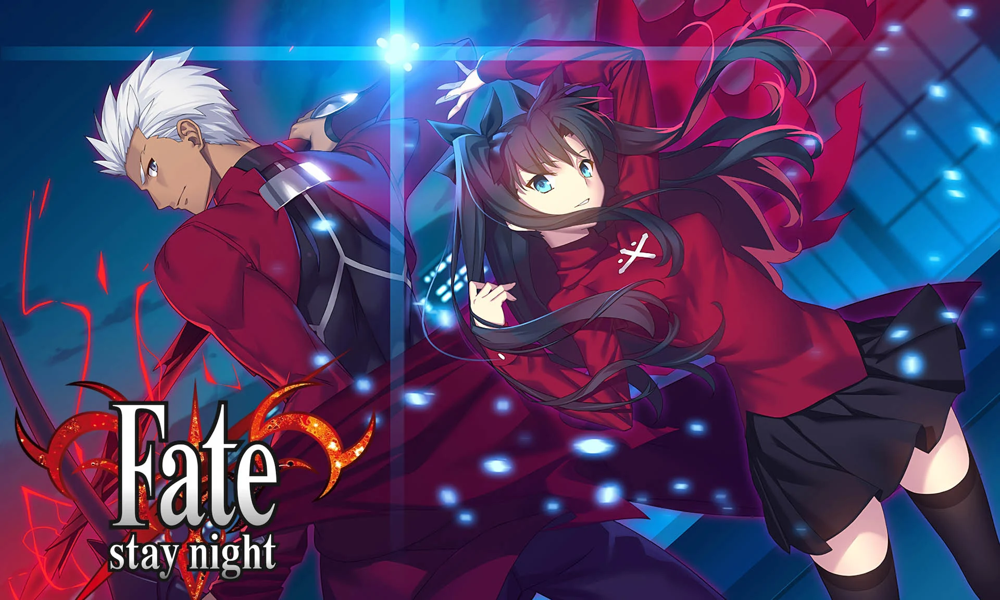

In [56]:
find_similar_animes("Fate/stay night [Unlimited Blade Works]", n=5, neg=False)

animes closest to Fate/stay night [Unlimited Blade Works]


,name,similarity,genre,sypnopsis
4,Fate/stay night [Unlimited Blade Works] Season 2,0.987061,"Action, Fantasy, Magic, Supernatural","In the midst of the Fifth Holy Grail War, Caster sets her plans into motion, beginning with the capture of Shirou's Servant Saber. With the witch growing ever more powerful, Rin and Archer determine she is a threat that must be dealt with at once. But as the balance of power in the war begins to shift, the Master and Servant find themselves walking separate ways. Meanwhile, despite losing his Servant and stumbling from injuries, Shirou ignores Rin's warning to abandon the battle royale, forcing his way into the fight against Caster. Determined to show his resolve in his will to fight, Shirou's potential to become a protector of the people is put to the test. Amidst the bloodshed and chaos, the motivations of each Master and Servant are slowly revealed as they sacrifice everything in order to arise as the victor and claim the Holy Grail."
3,Fate/Zero Season 2,0.886869,"Action, Supernatural, Magic, Fantasy","s the Fourth Holy Grail War rages on with no clear victor in sight, the remaining Servants and their Masters are called upon by Church supervisor Risei Kotomine, in order to band together and confront an impending threat that could unravel the Grail War and bring about the destruction of Fuyuki City. The uneasy truce soon collapses as Masters demonstrate that they will do anything in their power, no matter how despicable, to win. Seeds of doubt are sown between Kiritsugu Emiya and Saber, his Servant, as their conflicting ideologies on heroism and chivalry clash. Meanwhile, an ominous bond forms between Kirei Kotomine, who still seeks to find his purpose in life, and one of the remaining Servants. As the countdown to the end of the war reaches zero, the cost of winning begins to blur the line between victory and defeat."
2,Fate/Zero,0.868728,"Action, Supernatural, Magic, Fantasy","h the promise of granting any wish, the omnipotent Holy Grail triggered three wars in the past, each too cruel and fierce to leave a victor. In spite of that, the wealthy Einzbern family is confident that the Fourth Holy Grail War will be different; namely, with a vessel of the Holy Grail now in their grasp. Solely for this reason, the much hated ""Magus Killer"" Kiritsugu Emiya is hired by the Einzberns, with marriage to their only daughter Irisviel as binding contract. Kiritsugu now stands at the center of a cutthroat game of survival, facing off against six other participants, each armed with an ancient familiar, and fueled by unique desires and ideals. Accompanied by his own familiar, Saber, the notorious mercenary soon finds his greatest opponent in Kirei Kotomine, a priest who seeks salvation from the emptiness within himself in pursuit of Kiritsugu. Based on the light novel written by Gen Urobuchi, Fate/Zero depicts the events of the Fourth Holy Grail War—10 years prior to Fate/stay night . Witness a battle royale in which no one is guaranteed to survive."
1,Fate/stay night:Unlimited Blade Works - Prologue,0.844607,"Action, Fantasy, Magic, Supernatural","In Fuyuki City, a long-lived ritual involving battles between seven magi and their servants is taking place. This ritual is known as the Holy Grail War and it promises to grant the victor any wish. With the war now entering its fifth iteration, the stage is set for Rin Toosaka to succeed her father's legacy. Rin wishes to summon Saber, said to be the most powerful class. But when she miscalculates and summons Archer instead, how will she fare in the battles that lie ahead of her?"
0,Fate/stay night,0.683212,"Action, Supernatural, Magic, Romance, Fantasy","fter a mysterious inferno kills his family, Shirou is saved and adopted by Kiritsugu Emiya, who teaches him the ways of magic and justice. One night, years after Kiritsugu's death, Shirou is cleaning at school, when he finds himself caught in the middle of a deadly encounter between two superhumans known as Ser

### Task 2: Finding Similar Users (User Based Recommendation)

In [57]:
print('> picking up random user')

ratings_per_user = rating_df.groupby('user_id').size()
random_user = ratings_per_user[ratings_per_user < 500].sample(1, random_state=None).index[0]
print('> user_id:', random_user)

> picking up random user
> user_id: 10388


In [58]:
#pd.reset_option('all')
pd.set_option("max_colwidth", None)

def find_similar_users(item_input, n=10,return_dist=False, neg=False):
    try:
        index = item_input
        encoded_index = user2user_encoded.get(index)
        weights = user_weights
    
        dists = np.dot(weights, weights[encoded_index])
        sorted_dists = np.argsort(dists)
        
        n = n + 1
        
        if neg:
            closest = sorted_dists[:n]
        else:
            closest = sorted_dists[-n:]

        print('> users similar to #{}'.format(item_input))

        if return_dist:
            return dists, closest
        
        rindex = df
        SimilarityArr = []
        
        for close in closest:
            similarity = dists[close]

            if isinstance(item_input, int):
                decoded_id = user_encoded2user.get(close)
                SimilarityArr.append({"similar_users": decoded_id, 
                                      "similarity": similarity})

        Frame = pd.DataFrame(SimilarityArr).sort_values(by="similarity", 
                                                        ascending=False)
        
        return Frame
    
    except:
        print('{}!, Not Found in User list'.format(name))

In [59]:
similar_users = find_similar_users(int(random_user), 
                                   n=5, 
                                   neg=False)

similar_users = similar_users[similar_users.similarity > 0.4]
similar_users = similar_users[similar_users.similar_users != random_user]
similar_users.head(5)

> users similar to #10388


,similar_users,similarity
4,172097,0.443773
3,113102,0.437866
2,298708,0.436364
1,111468,0.429403
0,199415,0.428370


User preferences

In [61]:
from wordcloud import WordCloud
from collections import defaultdict
import matplotlib.pyplot as plt

def showWordCloud(all_genres):
    genres_cloud = WordCloud(width=700, height=400, 
                             background_color='white', 
                             colormap='gnuplot').generate_from_frequencies(all_genres)
    
    plt.figure(figsize=(10,8)) 
    plt.imshow(genres_cloud, interpolation='bilinear')
    plt.axis('off')
    plt.show()

def getFavGenre(frame, plot=False):
        frame.dropna(inplace=False)
        all_genres = defaultdict(int)
        
        genres_list = []
        for genres in frame['Genres']:
            if isinstance(genres, str):
                for genre in genres.split(','):
                    genres_list.append(genre)
                    all_genres[genre.strip()] += 1    
        if plot:
            showWordCloud(all_genres)
        
        return genres_list

    
def get_user_preferences(user_id, plot=False, verbose=0):
    animes_watched_by_user = rating_df[rating_df.user_id==user_id]
    user_rating_percentile = np.percentile(animes_watched_by_user.rating, 75)
    animes_watched_by_user = animes_watched_by_user[animes_watched_by_user.rating >= user_rating_percentile]
    top_animes_user = (
        animes_watched_by_user.sort_values(by="rating", ascending=False)#.head(10)
        .anime_id.values
    )
    
    anime_df_rows = df[df["anime_id"].isin(top_animes_user)]
    anime_df_rows = anime_df_rows[["eng_version", "Genres"]]
    
    if verbose != 0:
        print("> User #{} has rated {} movies (avg. rating = {:.1f})".format(
          user_id, len(animes_watched_by_user),
          animes_watched_by_user['rating'].mean(),
        ))
    
        print('> preferred genres')
    
    if plot:
        getFavGenre(anime_df_rows, plot)
        
    return anime_df_rows#.eng_version.values

> User #10388 has rated 130 movies (avg. rating = 0.9)
> preferred genres


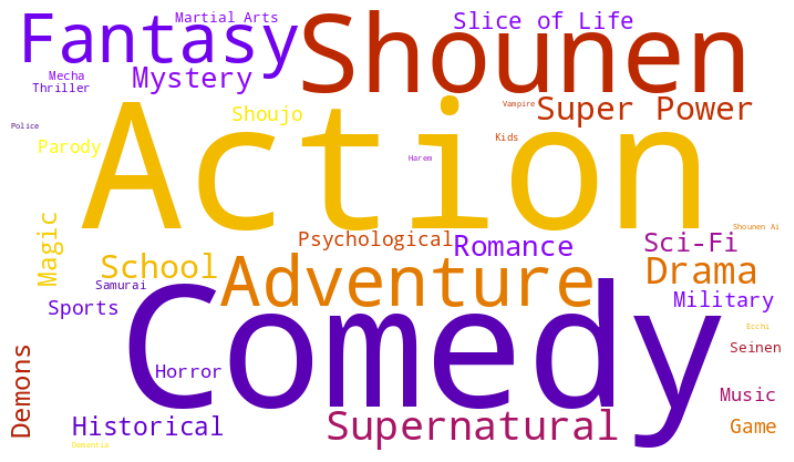

> animes highly rated by this user


,eng_version,Genres
3971,Fullmetal Alchemist:Brotherhood,"Action, Military, Adventure, Comedy, Drama, Magic, Fantasy, Shounen"
15926,Attack on Titan Final Season,"Action, Military, Mystery, Super Power, Drama, Fantasy, Shounen"
14963,Attack on Titan Season 3 Part 2,"Action, Drama, Fantasy, Military, Mystery, Shounen, Super Power"
6006,Gintama Season 2,"Action, Sci-Fi, Comedy, Historical, Parody, Samurai, Shounen"
11308,Your Name.,"Romance, Supernatural, School, Drama"


In [62]:
user_pref = get_user_preferences(random_user, plot=True, verbose=1)
print('> animes highly rated by this user')

pd.DataFrame(user_pref).head(5)

### Task 3: Recommending animes for a user

In [63]:
def get_recommended_animes(similar_users, n=10):
    recommended_animes = []
    anime_list = []
    
    for user_id in similar_users.similar_users.values:
        pref_list = get_user_preferences(int(user_id), verbose=0)
        pref_list = pref_list[~ pref_list.eng_version.isin(user_pref.eng_version.values)]
        anime_list.append(pref_list.eng_version.values)
        
    anime_list = pd.DataFrame(anime_list)
    sorted_list = pd.DataFrame(pd.Series(anime_list.values.ravel()).value_counts()).head(n)
    
    for i, anime_name in enumerate(sorted_list.index):        
        n_user_pref = sorted_list[sorted_list.index == anime_name].values[0][0]
        if isinstance(anime_name, str):
            try:
                frame = getAnimeFrame(anime_name)
                anime_id = frame.anime_id.values[0]
                genre = frame.Genres.values[0]
                sypnopsis = getSypnopsis(int(anime_id))
                recommended_animes.append({#"anime_id": anime_id ,
                                            "n": n_user_pref,
                                            "anime_name": anime_name, 
                                            "Genres": genre, 
                                            "sypnopsis": sypnopsis})
            except:
                pass
    
    return pd.DataFrame(recommended_animes)

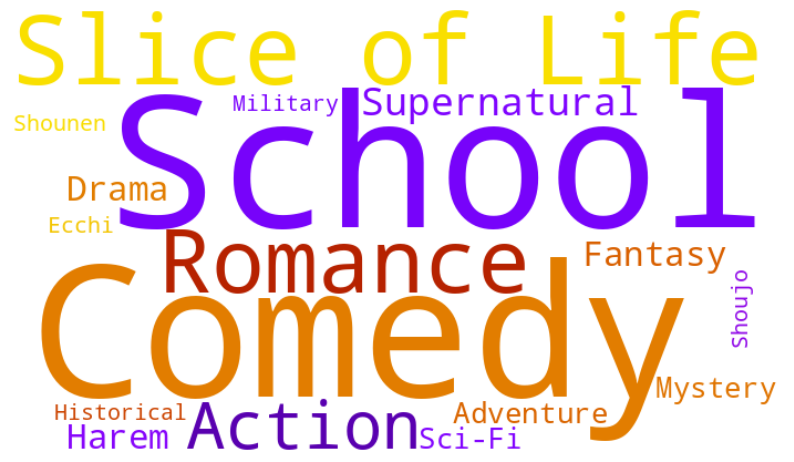


> Top recommendations for user: 10388


,n,anime_name,Genres,sypnopsis
0,5,KanColle:Kantai Collection,"Action, Military, Sci-Fi, Slice of Life, School","h the seas under constant threat from the hostile ""Abyssal Fleet,"" a specialized naval base is established to counter them. Rather than standard naval weaponry, however, the base is armed with ""Kanmusu""—girls who harbor the spirits of Japanese warships—possessing the ability to don weaponized gear that allows them to harness the powerful souls within themselves. Fubuki, a young Destroyer-type Kanmusu, joins the base as a new recruit; unfortunately for her, despite her inexperience and timid nature, she is assigned to the famous Third Torpedo Squadron and quickly thrust into the heat of battle. When she is rescued from near annihilation, the rookie warship resolves to become as strong as the one who saved her."
1,5,The Asterisk War,"Action, Comedy, Ecchi, Fantasy, Harem, Romance, School, Sci-Fi, Supernatural","In the previous century, an unprecedented disaster known as the Invertia drastically reformed the world. The powers of existing nations declined significantly, paving the way for a conglomerate called the Integrated Empire Foundation to assume control. But more importantly, the Invertia led to the emergence of a new species of humans who are born with phenomenal physical capabilities—the Genestella. Its elite are hand-picked across the globe to attend the top six schools, and they duel amongst themselves in entertainment battles called Festas. Ayato Amagiri is a scholarship transfer student at the prestigious Seidoukan Academy, which has recently been suffering from declining performances. Through a series of events, he accidentally sees the popular Witch of Resplendent Flames, Julis-Alexia von Riessfeld, half-dressed! Enraged, Julis challenges him to a duel for intruding on her privacy. After said duel is voided by the student council president, Ayato reveals that he has no interest in Festas. Instead, he has enrolled in the academy to investigate the whereabouts of his missing elder sister. But when a more devious plot unravels, Ayato sets out to achieve victory, while being surrounded by some of the most talented Genestella on the planet."
2,5,Nanana's Buried Treasure,"Adventure, Comedy, Mystery, Supernatural","Nanae Island is a man-made island in the Pacific Ocean that holds everything necessary for the proper education and training of children. It was created by the Great Seven, a group of adventurers headed by Nanana Ryuugajou, as a place for the young to chase their dreams. After being disowned and exiled by his family, high school student Juugo Yama arrives on this island, happy to finally be free of his father. Upon moving into his new room, he discovers the ghost of Nanana Ryuugajou, bound to the island after her unsolved murder 10 years ago. Nanana tells Juugo that, just before her death, she hid items with unique and mysterious powers all across the island—items known as the Nanana Collection. Hoping to uncover clues that will help him find the culprit behind her death, Juugo, with the help of self-proclaimed ""Master Detective"" Tensai Ikkyuu and her cross-dressing maid Daruku Hoshino, sets out on his search."
3,5,When Supernatural Battles Became Commonplace,"Harem, Slice of Life, Comedy, Supernatural, Romance, School","During a Literature Club meeting, the four club members—along with their faculty adviser's niece—suddenly find themselves with supernatural powers. Now capable of fabricating black flames, resident chuunibyou Jurai Andou is the most ecstatic about their new abilities; unfortunately, his own is only for show and unable to accomplish anything of substance. Moreover, he is completely outclassed by those around him: fellow club member Tomoyo Kanzaki manipulates time, Jurai's childhood friend Hatoko Kushikawa wields control over the five elements, club president Sayumi Takanashi can repair both inanimate objects and living things, and their adviser's niece Chifuyu Himeki is able to c

In [64]:
recommended_animes = get_recommended_animes(similar_users, n=10)
getFavGenre(recommended_animes, plot=True)

print('\n> Top recommendations for user: {}'.format(random_user))
recommended_animes

Ranking based Recommendation

In [65]:
print("Showing recommendations for user: {}".format(random_user))
print("===" * 25)

animes_watched_by_user = rating_df[rating_df.user_id==random_user]
anime_not_watched_df = df[
    ~df["anime_id"].isin(animes_watched_by_user.anime_id.values)
]

anime_not_watched = list(
    set(anime_not_watched_df['anime_id']).intersection(set(anime2anime_encoded.keys()))
)

anime_not_watched = [[anime2anime_encoded.get(x)] for x in anime_not_watched]

user_encoder = user2user_encoded.get(random_user)

user_anime_array = np.hstack(
    ([[user_encoder]] * len(anime_not_watched), anime_not_watched)
)

user_anime_array = [user_anime_array[:, 0], user_anime_array[:, 1]]
ratings = model.predict(user_anime_array).flatten()

top_ratings_indices = (-ratings).argsort()[:10]

recommended_anime_ids = [
    anime_encoded2anime.get(anime_not_watched[x][0]) for x in top_ratings_indices
]

Results = []
top_rated_ids = []

for index, anime_id in enumerate(anime_not_watched):
    rating = ratings[index]
    id_ = anime_encoded2anime.get(anime_id[0])
    
    if id_ in recommended_anime_ids:
        top_rated_ids.append(id_)
        try:
            condition = (df.anime_id == id_)
            name = df[condition]['eng_version'].values[0]
            genre = df[condition].Genres.values[0]
            score = df[condition].Score.values[0]
            sypnopsis = getSypnopsis(int(id_))
        except:
            continue
            
        Results.append({#"anime_id": id_, 
                        "name": name, 
                        "pred_rating": rating,
                        "genre": genre, 
                        'sypnopsis': sypnopsis})

print("---" * 25)
print("> Top 10 anime recommendations")
print("---" * 25)


Results = pd.DataFrame(Results).sort_values(by='pred_rating', ascending=False)
Results

Showing recommendations for user: 10388
535/535 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
---------------------------------------------------------------------------
> Top 10 anime recommendations
---------------------------------------------------------------------------


,name,pred_rating,genre,sypnopsis
0,Final Fantasy VII: Advent Children,0.814068,"Action, Super Power, Fantasy","Two years ago, the world was changed forever. The young Cloud Strife and his band of friends may have defeated Sephiroth and thwarted his plan to crash a giant meteor into the Earth, but this victory was not without great cost. The highly populated city of Midgar was nearly ripped apart in the conflict. Fortunately, many of the city's citizens were able to evacuate to safety, and in the years afterward have formed a new home called Edge. Final Fantasy VII: Advent Children revolves around Cloud and Tifa as they try to make new lives for themselves, as well as for those around them, in this new city. Together they run a courier service, and tend to their mutual friend Barret’s adopted daughter Marlene and a young orphan by the name of Denzel. Denzel, Cloud, and scores of children are suffering from a mysterious new illness called ""Geostigma."" The children of the city have one other threat looming over their heads—a trio of powerful men are kidnapping infected kids for unknown reasons. Cloud is determined to save these young ones, not only from Geostigma, but from the kidnappers as well. He has no idea, however, that these men share a link to his old enemy, Sephiroth, and Cloud’s quest to vanquish them will bring him back into conflict with the demons of his past. If there is any hope in conquering these threats, it lays within the bonds of friendship between Cloud and his allies who saved the world once, and now must do so again."
2,The Cat Returns,0.785259,"Adventure, Drama, Fantasy","High school student Haru Yoshioka is bored with the monotony of life. One day, she saves Prince Lune of the Cat Kingdom from being run over by a truck. As a token of gratitude, the Cat King sends her ""presents"" and invites her to the Cat Kingdom to become Lune's wife. Haru's inability to properly communicate with the cats leads to the misunderstanding that she has accepted the proposal. As Haru ponders on ways to escape the predicament, a mysterious voice instructs her to search for the Cat Bureau. However, not long after she finally arrives at the bureau, a horde of cats swarms in and forcibly takes her to the Cat Kingdom, along with a member of the Cat Bureau. Concerned for their safety, owner of the Cat Bureau, Baron Humbert von Gikkingen, follows close behind. The more Haru immerses herself in the activities of the Cat Kingdom, the more cat-like she becomes. To her dismay, she soon learns that, unless she can find her true self, she may become a cat permanently. Haru's adventures in the world of cats lead her down a path to self-discovery, allowing her to return as a more confident person."
8,Rusty Nail,0.667201,"Action, Music, Sci-Fi","usty Nail is a X Japan's anime music video produced by CLAMP and included on VHS as a first press bonus for the ""PERFECT BEST' compilation album, released in 1999. The video shows anime versions of the band: YOSHIKI, ToshI, hide, PATA and HEATH in a sci-fi like scenario. (Source: Music Japan Plus / X Japan Wiki)"
1,Miss Kobayashi's Dragon Maid,0.664336,"Slice of Life, Comedy, Fantasy","s Kobayashi sets off for another day at work, she opens her apartment door only to be met by an unusually frightening sight—the head of a dragon, staring at her from across the balcony. The dragon immediately transforms into a cute, busty, and energetic young girl dressed in a maid outfit, introducing herself as Tooru. It turns out that the stoic programmer had come across the dragon the previous night on a drunken excursion to the mountains, and since the mythical beast had nowhere else to go, she had offered the creature a place to stay in her home. Thus, Tooru had arrived to cash in on the offer, ready to repay her savior's kindness by working as her personal maidservant. Though deeply regretful of her words and hesitant to follow through on her promise, a mix of guilt and Tooru's incredible dragon abilities con

In [66]:
model.save('anime_model.h5')

from IPython.display import FileLink
FileLink(r'./anime_model.h5')

/home/estaid/mydoc/anime_model.h5